In [3]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.impute import KNNImputer
from sklearn.model_selection import train_test_split
from imblearn.over_sampling import SMOTE
import plotly.express as px
from sklearn.linear_model import LinearRegression # this could be any ML method
from sklearn.metrics import mean_squared_error, r2_score
from sklearn.experimental import enable_iterative_imputer
from sklearn.impute import IterativeImputer, SimpleImputer
from sklearn.preprocessing import StandardScaler, RobustScaler
import plotly.figure_factory as ff

# Citations

* Homicide Reports from 1980-2014 from Kaggle, link https://www.kaggle.com/datasets/murderaccountability/homicide-reports
* US Unemployment Dataset from 2010-2020, link https://www.kaggle.com/datasets/aniruddhasshirahatti/us-unemployment-dataset-2010-2020
* Crime and Incarceration in the United States, link https://www.kaggle.com/datasets/christophercorrea/prisoners-and-crime-in-united-states

# Topic:"Demographic and Economic Patterns in Homicide Incidents

# Data Collection and Preparation

### Summary of Data Collection and Preparation 

* **Datasets**: For my datasets, I found two different datasets. The first dataset is from kaggle and has data about homicides in the United States starting in 1980. The second dataset I found on kaggle as well, and that dataset focused on Unemployment rates in the United States starting in 2010.
* **Preparation:** After loading in my datasets, I used .head() and .describe() to see if there were any missing variables. I found that in the Homicide dataset, there were no missing numerical values, but there were categorical variables that had "Unknown" as values. I converted the unknown values to Na values using numpy. After using .describe() on the Unemployment dataset, I noticed each numerical column was missing about 10 data points.
* **Handling missing data:** After noticing there were missing data points, I used a heatmap to show where all the missing variables were. After that, I used two different methods to impute values where the missing values were. I compared the MICE and mean imputation, and then went with the knn imputation, as I thought it did a better job.
* **Overall Unemployment Column:** A column called "Overall Unemployment rate" was created, to display the average unemployment using the columns from the unemployment dataset column for each year. This could allow for better analysis.
* **Masking the Data:** Since only adults are typically employed, I thought it made the most sense to filter the age to only individuals older than 18. 
* **Encoding Categorical Columns:** I encoded the columns "Perpetrator Sex", "Perpetrator Race", "Victim Sex", and "Victim Race". If the perpetrators sex is male, the column takes a 1 and a 0 if the perpetrators sex is female. If the victim's sex is female, it takes a 0 and a 1 if the victim's sex is male. In both datasets, the months were changed from January-December to 1-12, to allow for easier analysis. 

In [5]:
import pandas as pd
import pandas as pd
import zipfile

zip_file_path = 'database.csv.zip'

with zipfile.ZipFile(zip_file_path, 'r') as z:
    file_names = z.namelist()
    with z.open('database.csv') as csv_file:
        homicide_data = pd.read_csv(csv_file)




/var/folders/xc/rg0fmqqj79g5khf9z862dtpw0000gn/T/ipykernel_80763/1194420476.py:10: DtypeWarning: Columns (16) have mixed types. Specify dtype option on import or set low_memory=False.
  homicide_data = pd.read_csv(csv_file)


In [6]:
homicide_data.head()

,Record ID,Agency Code,Agency Name,Agency Type,City,State,Year,Month,Incident,Crime Type,...,Victim Ethnicity,Perpetrator Sex,Perpetrator Age,Perpetrator Race,Perpetrator Ethnicity,Relationship,Weapon,Victim Count,Perpetrator Count,Record Source
0,1,AK00101,Anchorage,Municipal Police,Anchorage,Alaska,1980,January,1,Murder or Manslaughter,...,Unknown,Male,15,Native American/Alaska Native,Unknown,Acquaintance,Blunt Object,0,0,FBI
1,2,AK00101,Anchorage,Municipal Police,Anchorage,Alaska,1980,March,1,Murder or Manslaughter,...,Unknown,Male,42,White,Unknown,Acquaintance,Strangulation,0,0,FBI
2,3,AK00101,Anchorage,Municipal Police,Anchorage,Alaska,1980,March,2,Murder or Manslaughter,...,Unknown,Unknown,0,Unknown,Unknown,Unknown,Unknown,0,0,FBI
3,4,AK00101,Anchorage,Municipal Police,Anchorage,Alaska,1980,April,1,Murder or Manslaughter,...,Unknown,Male,42,White,Unknown,Acquaintance,Strangulation,0,0,FBI
4,5,AK00101,Anchorage,Municipal Police,Anchorage,Alaska,1980,April,2,Murder or Manslaughter,...,Unknown,Unknown,0,Unknown,Unknown,Unknown,Unknown,0,1,FBI


In [9]:
#loading in the datasets

us_unemployment = pd.read_csv('unemployment_data_us.csv')
us_unemployment.head()

,Year,Month,Primary_School,Date,High_School,Associates_Degree,Professional_Degree,White,Black,Asian,Hispanic,Men,Women
0,2010,Jan,15.3,Jan-2010,10.2,8.6,4.9,8.8,16.5,8.3,12.9,10.2,7.9
1,2011,Jan,14.3,Jan-2011,9.5,8.1,4.3,8.1,15.8,6.8,12.3,9.0,7.9
2,2012,Jan,13.0,Jan-2012,8.5,7.1,4.3,7.4,13.6,6.7,10.7,7.7,7.6
3,2013,Jan,12.0,Jan-2013,8.1,6.9,3.8,7.1,13.7,6.4,9.7,7.5,7.2
4,2014,Jan,9.4,Jan-2014,6.5,5.9,3.3,5.7,12.1,4.7,8.3,6.2,5.8


In [11]:
crime = pd.read_csv('crime_and_incarceration.csv')
crime.head()


,jurisdiction,includes_jails,year,prisoner_count,crime_reporting_change,crimes_estimated,state_population,violent_crime_total,murder_manslaughter,rape_legacy,rape_revised,robbery,agg_assault,property_crime_total,burglary,larceny,vehicle_theft
0,FEDERAL,False,2001,149852,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,ALABAMA,False,2001,24741,False,False,4468912.0,19582.0,379.0,1369.0,NaN,5584.0,12250.0,173253.0,40642.0,119992.0,12619.0
2,ALASKA,True,2001,4570,False,False,633630.0,3735.0,39.0,501.0,NaN,514.0,2681.0,23160.0,3847.0,16695.0,2618.0
3,ARIZONA,False,2001,27710,False,False,5306966.0,28675.0,400.0,1518.0,NaN,8868.0,17889.0,293874.0,54821.0,186850.0,52203.0
4,ARKANSAS,False,2001,11489,False,False,2694698.0,12190.0,148.0,892.0,NaN,2181.0,8969.0,99106.0,22196.0,69590.0,7320.0


In [13]:
#replace the unknown values in the homicide data with NA's
homicide_data.replace("Unknown", np.nan, inplace=True)
homicide_data.head()

,Record ID,Agency Code,Agency Name,Agency Type,City,State,Year,Month,Incident,Crime Type,...,Victim Ethnicity,Perpetrator Sex,Perpetrator Age,Perpetrator Race,Perpetrator Ethnicity,Relationship,Weapon,Victim Count,Perpetrator Count,Record Source
0,1,AK00101,Anchorage,Municipal Police,Anchorage,Alaska,1980,January,1,Murder or Manslaughter,...,NaN,Male,15,Native American/Alaska Native,NaN,Acquaintance,Blunt Object,0,0,FBI
1,2,AK00101,Anchorage,Municipal Police,Anchorage,Alaska,1980,March,1,Murder or Manslaughter,...,NaN,Male,42,White,NaN,Acquaintance,Strangulation,0,0,FBI
2,3,AK00101,Anchorage,Municipal Police,Anchorage,Alaska,1980,March,2,Murder or Manslaughter,...,NaN,NaN,0,NaN,NaN,NaN,NaN,0,0,FBI
3,4,AK00101,Anchorage,Municipal Police,Anchorage,Alaska,1980,April,1,Murder or Manslaughter,...,NaN,Male,42,White,NaN,Acquaintance,Strangulation,0,0,FBI
4,5,AK00101,Anchorage,Municipal Police,Anchorage,Alaska,1980,April,2,Murder or Manslaughter,...,NaN,NaN,0,NaN,NaN,NaN,NaN,0,1,FBI


In [15]:
#checking the types of data
homicide_data.describe() #no missing numerical variables

,Record ID,Year,Incident,Victim Age,Victim Count,Perpetrator Count
count,638454.00000,638454.000000,638454.000000,638454.000000,638454.000000,638454.000000
mean,319227.50000,1995.801102,22.967924,35.033512,0.123334,0.185224
std,184305.93872,9.927693,92.149821,41.628306,0.537733,0.585496
min,1.00000,1980.000000,0.000000,0.000000,0.000000,0.000000
25%,159614.25000,1987.000000,1.000000,22.000000,0.000000,0.000000
50%,319227.50000,1995.000000,2.000000,30.000000,0.000000,0.000000
75%,478840.75000,2004.000000,10.000000,42.000000,0.000000,0.000000
max,638454.00000,2014.000000,999.000000,998.000000,10.000000,10.000000


In [17]:
us_unemployment.describe() #there are some missing variables 

,Year,Primary_School,High_School,Associates_Degree,Professional_Degree,White,Black,Asian,Hispanic,Men,Women
count,132.000000,123.000000,123.000000,123.000000,123.000000,123.000000,123.000000,123.000000,123.000000,123.000000,123.000000
mean,2015.000000,9.329268,6.391057,5.338211,3.127642,5.455285,10.692683,4.679675,7.660163,5.848780,5.485366
std,3.174324,3.343178,2.223607,1.895314,0.937585,1.881454,3.615907,1.668363,2.837274,2.160577,1.750910
min,2010.000000,4.800000,3.400000,2.700000,1.900000,3.100000,5.400000,2.100000,3.900000,3.100000,3.100000
25%,2012.000000,6.350000,4.450000,3.700000,2.300000,3.750000,7.400000,3.300000,5.050000,3.950000,3.900000
50%,2015.000000,8.500000,5.500000,4.900000,2.800000,4.800000,10.300000,4.200000,6.800000,5.200000,5.000000
75%,2018.000000,12.250000,8.300000,7.000000,4.000000,7.250000,13.900000,6.050000,10.150000,7.600000,7.400000
max,2020.000000,15.800000,11.000000,8.900000,5.000000,9.000000,16.800000,8.300000,12.900000,10.300000,8.400000


In [19]:
crime.describe()

,year,prisoner_count,state_population,violent_crime_total,murder_manslaughter,rape_legacy,rape_revised,robbery,agg_assault,property_crime_total,burglary,larceny,vehicle_theft
count,816.000000,816.000000,7.990000e+02,799.000000,799.000000,749.000000,199.000000,799.000000,799.000000,7.990000e+02,799.000000,799.000000,799.000000
mean,2008.500000,28606.033088,6.072322e+06,26228.459324,313.702128,1788.339119,2406.195980,7696.824781,16256.270338,1.878006e+05,40870.408010,127912.287860,19017.904881
std,4.612599,39556.940699,6.725500e+06,33866.838388,386.019821,1865.443299,2550.486639,11107.478615,20849.515589,2.138503e+05,47829.948836,139434.591858,30780.350362
min,2001.000000,1088.000000,4.937540e+05,496.000000,5.000000,99.000000,110.000000,43.000000,270.000000,8.806000e+03,1689.000000,6660.000000,178.000000
25%,2004.750000,5698.000000,1.790026e+06,5213.000000,48.500000,571.000000,780.000000,1106.000000,3529.000000,4.749750e+04,9406.000000,32765.500000,4191.000000
50%,2008.500000,16915.000000,4.314113e+06,15744.000000,179.000000,1238.000000,1723.000000,3933.000000,10083.000000,1.327730e+05,27698.000000,95079.000000,10583.000000
75%,2012.250000,30920.500000,6.808844e+06,31843.000000,429.000000,2092.000000,2680.000000,8702.000000,20308.000000,2.259575e+05,47941.000000,155688.000000,20872.500000
max,2016.000000,216915.000000,3.929648e+07,212867.000000,2503.000000,10198.000000,13702.000000,71142.000000,136087.000000,1.227194e+06,250521.000000,731486.000000,257543.000000


In [21]:


crime['jurisdiction'] = crime['jurisdiction'].apply(lambda x: x.capitalize() if x.isupper() else x)
crime = crime.rename(columns={"jurisdiction": "State"})
crime.head()

,State,includes_jails,year,prisoner_count,crime_reporting_change,crimes_estimated,state_population,violent_crime_total,murder_manslaughter,rape_legacy,rape_revised,robbery,agg_assault,property_crime_total,burglary,larceny,vehicle_theft
0,Federal,False,2001,149852,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,Alabama,False,2001,24741,False,False,4468912.0,19582.0,379.0,1369.0,NaN,5584.0,12250.0,173253.0,40642.0,119992.0,12619.0
2,Alaska,True,2001,4570,False,False,633630.0,3735.0,39.0,501.0,NaN,514.0,2681.0,23160.0,3847.0,16695.0,2618.0
3,Arizona,False,2001,27710,False,False,5306966.0,28675.0,400.0,1518.0,NaN,8868.0,17889.0,293874.0,54821.0,186850.0,52203.0
4,Arkansas,False,2001,11489,False,False,2694698.0,12190.0,148.0,892.0,NaN,2181.0,8969.0,99106.0,22196.0,69590.0,7320.0


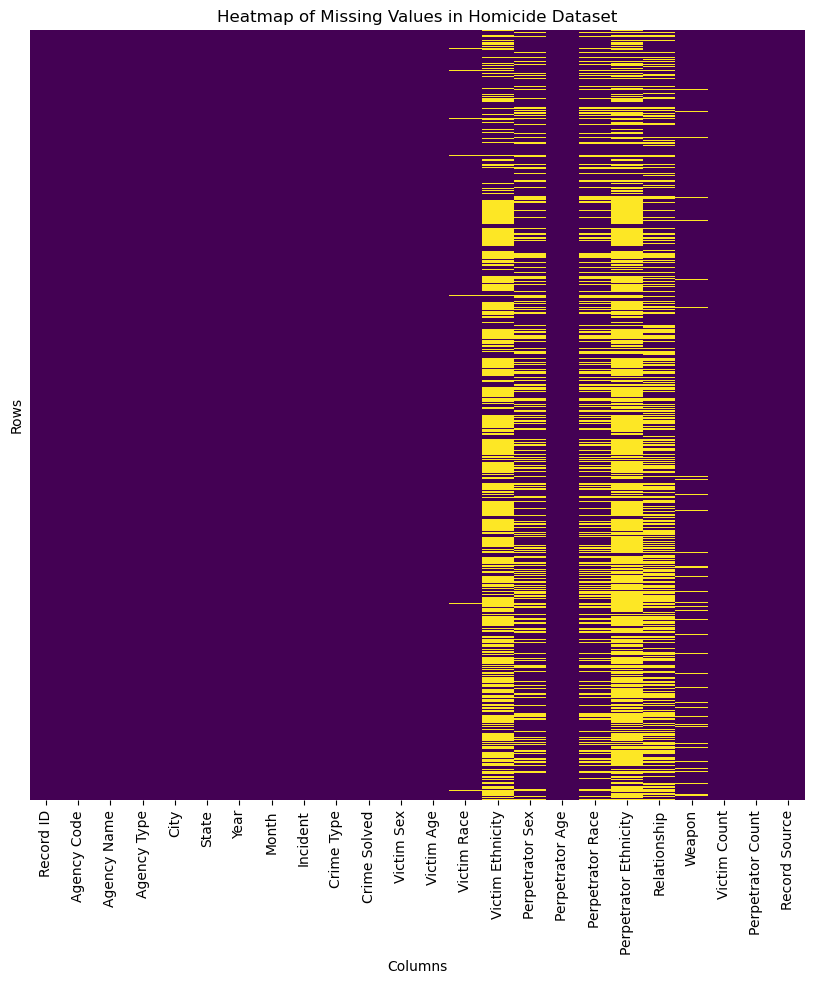

In [21]:
#looking at missing datasets
missing_values = homicide_data.isnull()

plt.figure(figsize=(10, 10))
sns.heatmap(missing_values, cbar=False, cmap='viridis', yticklabels=False)
plt.title('Heatmap of Missing Values in Homicide Dataset', fontsize=12)
plt.xlabel('Columns')
plt.ylabel('Rows')
plt.show()

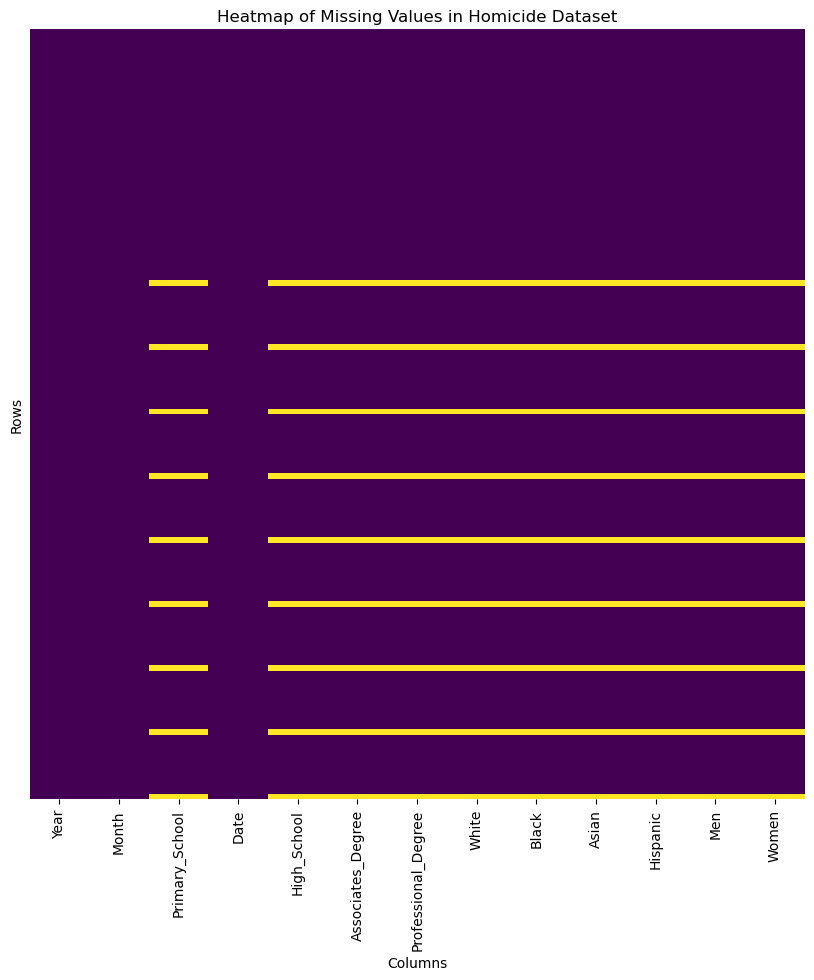

In [22]:
missing_values = us_unemployment.isnull()

plt.figure(figsize=(10, 10))
sns.heatmap(missing_values, cbar=False, cmap='viridis', yticklabels=False)
plt.title('Heatmap of Missing Values in Homicide Dataset', fontsize=12)
plt.xlabel('Columns')
plt.ylabel('Rows')
plt.show()

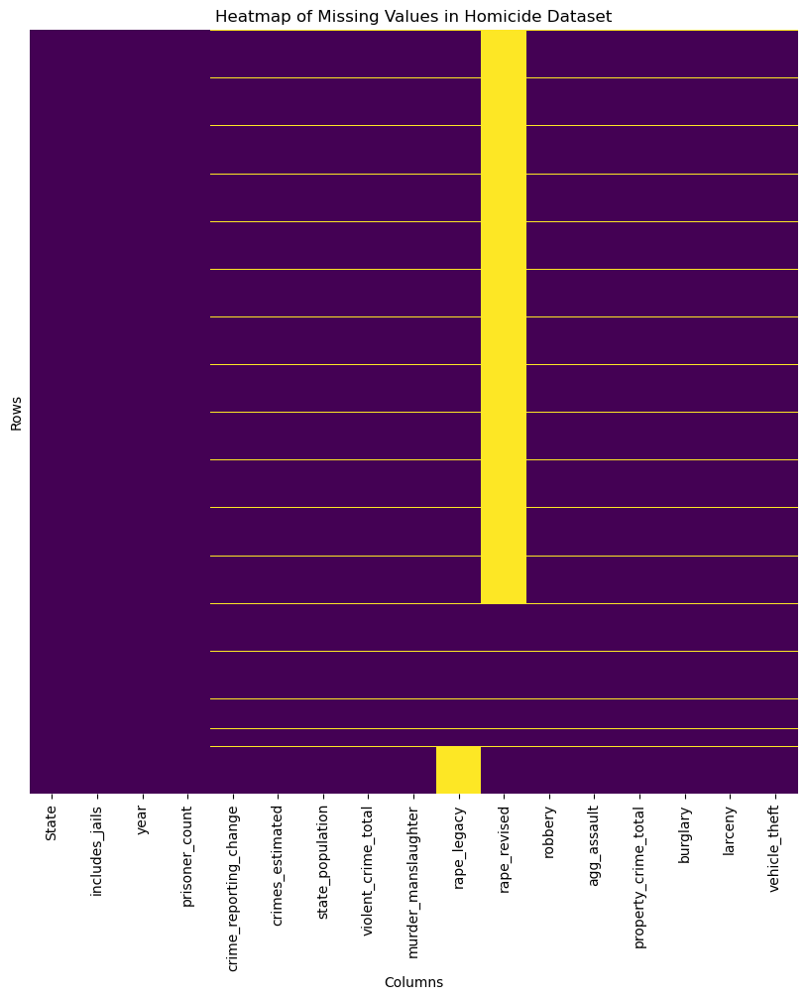

In [25]:
missing_values = crime.isnull()

plt.figure(figsize=(10, 10))
sns.heatmap(missing_values, cbar=False, cmap='viridis', yticklabels=False)
plt.title('Heatmap of Missing Values in Homicide Dataset', fontsize=12)
plt.xlabel('Columns')
plt.ylabel('Rows')
plt.show()

In [23]:
filtered_violence = homicide_data.rename(columns={"Year": "year"})
month_mapping = {
    'January': 1, 'Febuary': 2, 'March': 3, 'April': 4,
    'May': 5, 'June': 6, 'July': 7, 'August': 8,
    'September': 9, 'October': 10, 'November': 11, 'December': 12
}

filtered_violence['month'] = filtered_violence['Month'].map(month_mapping)
filtered_violence.drop(columns=['Month'], inplace=True)

In [25]:
#filtered_unemployment = us_unemployment[(us_unemployment['Year'] >= 2012) & (us_unemployment['Year'] <= 2014)]
filtered_unemployment = us_unemployment.rename(columns={"Year": "year"})
month_mapping = {
    'Jan': 1, 'Feb': 2, 'Mar': 3, 'Apr': 4,
    'May': 5, 'Jun': 6, 'Jul': 7, 'Aug': 8,
    'Sep': 9, 'Oct': 10, 'Nov': 11, 'Dec': 12
}
filtered_unemployment['month'] = filtered_unemployment['Month'].map(month_mapping)
filtered_unemployment.drop(columns=['Month'], inplace=True)

In [27]:
#merge the datasets
merged_data0 = pd.merge(filtered_violence, filtered_unemployment, on=['year','month'])
merged_data = pd.merge(merged_data0, crime, on=['year', 'State'])

In [29]:
#dropping columns that are not relevant/ I won't be using, as this dataset is now huge
merged_data = merged_data.drop(['Record ID', 'Agency Code','City','Incident','Agency Name','Agency Type','Record Source', 'includes_jails'], axis=1)
merged_data.head()

,State,year,Crime Type,Crime Solved,Victim Sex,Victim Age,Victim Race,Victim Ethnicity,Perpetrator Sex,Perpetrator Age,...,violent_crime_total,murder_manslaughter,rape_legacy,rape_revised,robbery,agg_assault,property_crime_total,burglary,larceny,vehicle_theft
0,Alaska,2010,Murder or Manslaughter,Yes,Female,19,White,NaN,Male,21,...,4537.0,31.0,533.0,NaN,594.0,3379.0,20259.0,3105.0,15535.0,1619.0
1,Alaska,2010,Murder or Manslaughter,No,Male,44,White,NaN,NaN,0,...,4537.0,31.0,533.0,NaN,594.0,3379.0,20259.0,3105.0,15535.0,1619.0
2,Alaska,2010,Murder or Manslaughter,Yes,Male,40,Black,NaN,Male,35,...,4537.0,31.0,533.0,NaN,594.0,3379.0,20259.0,3105.0,15535.0,1619.0
3,Alaska,2010,Murder or Manslaughter,Yes,Male,26,White,NaN,Female,26,...,4537.0,31.0,533.0,NaN,594.0,3379.0,20259.0,3105.0,15535.0,1619.0
4,Alaska,2010,Murder or Manslaughter,Yes,Male,34,Asian/Pacific Islander,NaN,Male,26,...,4537.0,31.0,533.0,NaN,594.0,3379.0,20259.0,3105.0,15535.0,1619.0


In [31]:
#display the new dataset now
merged_data.columns

Index(['State', 'year', 'Crime Type', 'Crime Solved', 'Victim Sex',
       'Victim Age', 'Victim Race', 'Victim Ethnicity', 'Perpetrator Sex',
       'Perpetrator Age', 'Perpetrator Race', 'Perpetrator Ethnicity',
       'Relationship', 'Weapon', 'Victim Count', 'Perpetrator Count', 'month',
       'Primary_School', 'Date', 'High_School', 'Associates_Degree',
       'Professional_Degree', 'White', 'Black', 'Asian', 'Hispanic', 'Men',
       'Women', 'prisoner_count', 'crime_reporting_change', 'crimes_estimated',
       'state_population', 'violent_crime_total', 'murder_manslaughter',
       'rape_legacy', 'rape_revised', 'robbery', 'agg_assault',
       'property_crime_total', 'burglary', 'larceny', 'vehicle_theft'],
      dtype='object')

MICE Imputation Results:
Mean Squared Error (log scale): 0.1086
R2 Score: 0.9769

Mean Imputation Results:
Mean Squared Error (log scale): 0.1086
R2 Score: 0.9769


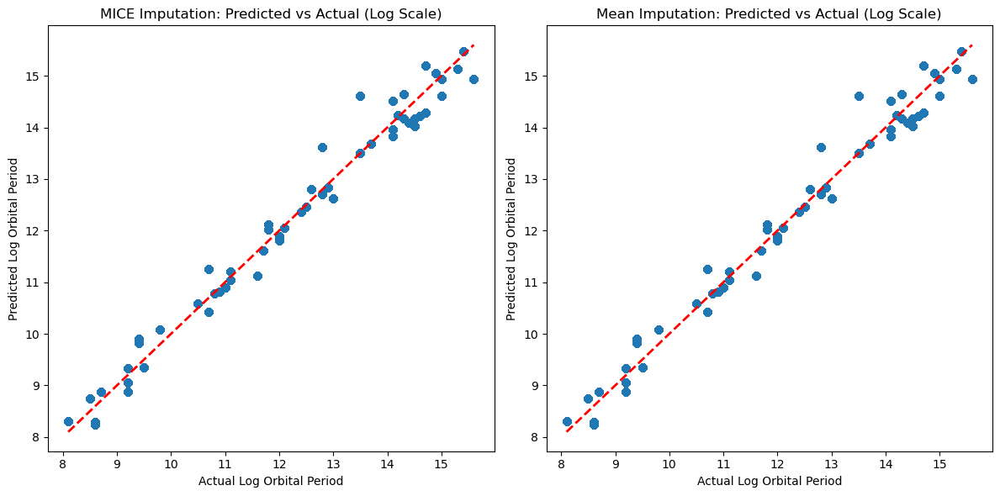


Feature Importances (MICE):
               feature  importance
9                Women    2.316972
8                  Men    2.213368
7             Hispanic    1.572303
4                White    1.356837
1          High_School    1.180193
3  Professional_Degree    0.442312
0                 year    0.332827
5                Black    0.283370
2    Associates_Degree    0.279063
6                Asian    0.180316

Feature Importances (Mean):
               feature  importance
9                Women    2.316972
8                  Men    2.213368
7             Hispanic    1.572303
4                White    1.356837
1          High_School    1.180193
3  Professional_Degree    0.442312
0                 year    0.332827
5                Black    0.283370
2    Associates_Degree    0.279063
6                Asian    0.180316

Exponentiated MSE (MICE): 1.1147
Exponentiated MSE (Mean): 1.1147


In [33]:
columns_to_use = ['year', 'Primary_School', 'High_School', 'Associates_Degree', 'Professional_Degree','White', 'Black', 'Asian', 'Hispanic', 'Men',
       'Women'] #selecting the numerical columns which are the columns we want to use
data = merged_data[columns_to_use].copy() #creating a copy of the dataset 


X = data[['year', 'High_School', 'Associates_Degree', 'Professional_Degree','White', 'Black', 'Asian', 'Hispanic', 'Men',
       'Women']]
y = data['Primary_School']


X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)


scaler = RobustScaler()
X_train_scaled = pd.DataFrame(scaler.fit_transform(X_train), columns=X_train.columns, index=X_train.index)
X_test_scaled = pd.DataFrame(scaler.transform(X_test), columns=X_test.columns, index=X_test.index)

mice_imputer = IterativeImputer(random_state=42, max_iter=50)
X_train_mice = pd.DataFrame(mice_imputer.fit_transform(X_train_scaled), 
                            columns=X_train.columns, index=X_train.index)
X_test_mice = pd.DataFrame(mice_imputer.transform(X_test_scaled), 
                           columns=X_test.columns, index=X_test.index)


lr_mice = LinearRegression()
lr_mice.fit(X_train_mice, y_train)

y_pred_mice = lr_mice.predict(X_test_mice)
mse_mice = mean_squared_error(y_test, y_pred_mice)
r2_mice = r2_score(y_test, y_pred_mice)

print(f"MICE Imputation Results:")
print(f"Mean Squared Error (log scale): {mse_mice:.4f}")
print(f"R2 Score: {r2_mice:.4f}")

mean_imputer = SimpleImputer(strategy='mean')
X_train_mean = pd.DataFrame(mean_imputer.fit_transform(X_train_scaled), 
                            columns=X_train.columns, index=X_train.index)
X_test_mean = pd.DataFrame(mean_imputer.transform(X_test_scaled), 
                           columns=X_test.columns, index=X_test.index)

lr_mean = LinearRegression()
lr_mean.fit(X_train_mean, y_train)
y_pred_mean = lr_mean.predict(X_test_mean)
mse_mean = mean_squared_error(y_test, y_pred_mean)
r2_mean = r2_score(y_test, y_pred_mean)

print(f"\nMean Imputation Results:")
print(f"Mean Squared Error (log scale): {mse_mean:.4f}")
print(f"R2 Score: {r2_mean:.4f}")

plt.figure(figsize=(12, 6))

plt.subplot(1, 2, 1)
plt.scatter(y_test, y_pred_mice, alpha=0.5)
plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'r--', lw=2)
plt.xlabel('Actual Log Orbital Period')
plt.ylabel('Predicted Log Orbital Period')
plt.title('MICE Imputation: Predicted vs Actual (Log Scale)')

plt.subplot(1, 2, 2)
plt.scatter(y_test, y_pred_mean, alpha=0.5)
plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'r--', lw=2)
plt.xlabel('Actual Log Orbital Period')
plt.ylabel('Predicted Log Orbital Period')
plt.title('Mean Imputation: Predicted vs Actual (Log Scale)')

plt.tight_layout()
plt.show()


feature_importance_mice = pd.DataFrame({'feature': X_train.columns, 'importance': np.abs(lr_mice.coef_)})
feature_importance_mice = feature_importance_mice.sort_values('importance', ascending=False)
print("\nFeature Importances (MICE):")
print(feature_importance_mice)

feature_importance_mean = pd.DataFrame({'feature': X_train.columns, 'importance': np.abs(lr_mean.coef_)})
feature_importance_mean = feature_importance_mean.sort_values('importance', ascending=False)
print("\nFeature Importances (Mean):")
print(feature_importance_mean)

print(f"\nExponentiated MSE (MICE): {np.exp(mse_mice):.4f}")
print(f"Exponentiated MSE (Mean): {np.exp(mse_mean):.4f}")

In [35]:
#knn for numerical data points
import pandas as pd
import numpy as np
from sklearn.preprocessing import StandardScaler
from sklearn.impute import KNNImputer


numeric_columns = merged_data.select_dtypes(include=[np.number]).columns
homicide_numeric = merged_data[numeric_columns]


data_with_missing = homicide_numeric[homicide_numeric.isnull().any(axis=1)]
homicide_without_missing = homicide_numeric.dropna()

scaler = StandardScaler()
homicide_scaled = pd.DataFrame(scaler.fit_transform(homicide_without_missing), columns=homicide_without_missing.columns)

# initialize and fit KNN imputer
imputer = KNNImputer(n_neighbors=5)
imputer.fit(homicide_scaled)

# function to impute and inverse transform the data
def impute_and_inverse_transform(data):
    # Ensure 'data' is always a DataFrame with proper column names
    scaled_data = pd.DataFrame(scaler.transform(data), columns=data.columns, index=data.index)
    imputed_scaled = imputer.transform(scaled_data)
    return pd.DataFrame(scaler.inverse_transform(imputed_scaled), columns=data.columns, index=data.index)

# impute missing values
homicide_imputed = impute_and_inverse_transform(homicide_numeric)

# Update the original dataset with the imputed numerical data
merged_data[numeric_columns] = homicide_imputed

In [37]:
#using simple input for categorical variables
categorical_columns = ['Crime Type', 'Perpetrator Sex', 'Victim Sex','Perpetrator Race','Perpetrator Ethnicity' ,'Victim Race'
                       ,'Victim Ethnicity','Relationship','Weapon', 'State', 'crime_reporting_change', 'crimes_estimated']
imputer = SimpleImputer(strategy='most_frequent')
merged_data[categorical_columns] = imputer.fit_transform(merged_data[categorical_columns])

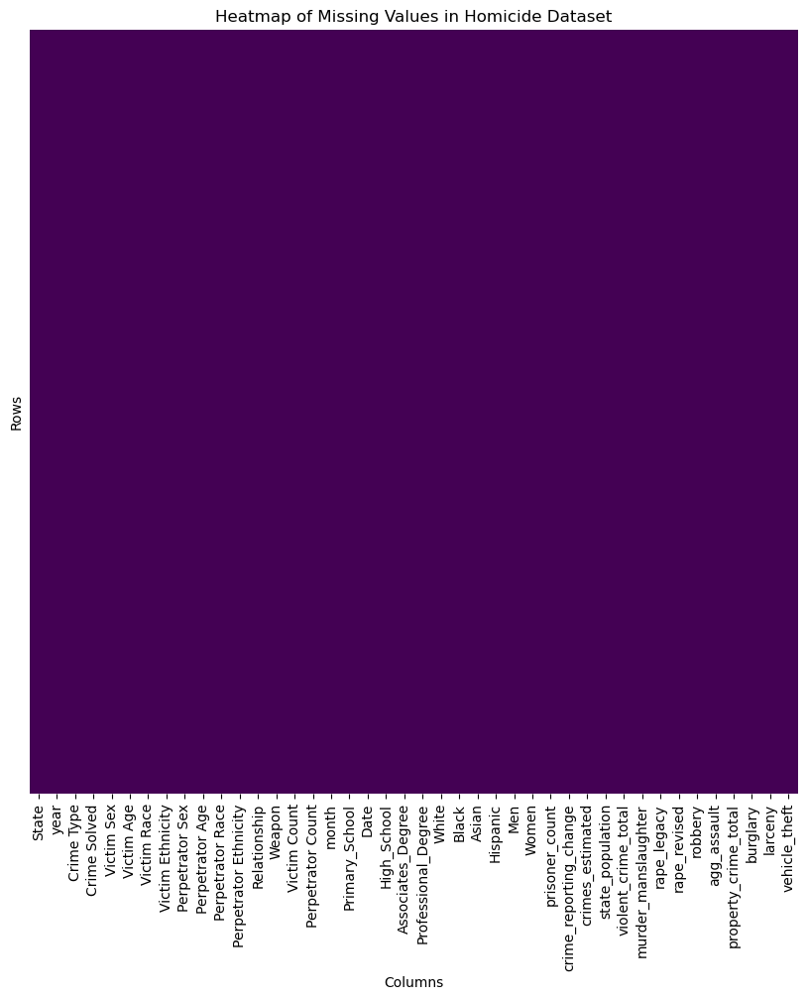

In [37]:
#checking that all the missing values are gone
missing_values = merged_data.isnull()

plt.figure(figsize=(10, 10))
sns.heatmap(missing_values, cbar=False, cmap='viridis', yticklabels=False)
plt.title('Heatmap of Missing Values in Homicide Dataset', fontsize=12)
plt.xlabel('Columns')
plt.ylabel('Rows')
plt.show()

In [39]:
#masking (I only want to look at indiviudals 18 or older as those are adults who could be unemployed)
merged_data['Perpetrator Age'] = pd.to_numeric(merged_data['Perpetrator Age'], errors='coerce').astype('Int64')
merged_data = merged_data[(merged_data['Victim Age'] >= 18.0)]
merged_data = merged_data[(merged_data['Perpetrator Age'] >= 18.0)]


In [41]:
unemployment_columns = ['Primary_School', 'High_School', 'Associates_Degree', 
                        'Professional_Degree', 'White', 'Black', 'Asian', 
                        'Hispanic', 'Men', 'Women']

merged_data['Overall_Unemployment_Rate'] = merged_data[unemployment_columns].mean(axis=1)

In [43]:
#assigns a 1 if greater than the median and a 0 if less than the median
merged_data['high_crime'] = (merged_data['violent_crime_total'] > merged_data['violent_crime_total'].median()).astype(int)

In [45]:
#encoding sex
from sklearn.preprocessing import LabelEncoder, OneHotEncoder, OrdinalEncoder
le = LabelEncoder()
merged_data['Victim_Sex_encoded'] = le.fit_transform(merged_data['Victim Sex'])
merged_data['Perpetrator_Sex_encoded'] = le.fit_transform(merged_data['Perpetrator Sex'])
merged_data['Victim_Race_encoded'] = le.fit_transform(merged_data['Victim Race'])
merged_data['Perpetrator_Race_encoded'] = le.fit_transform(merged_data['Perpetrator Race'])
merged_data['Perpetrator_Ethnicity_encoded'] = le.fit_transform(merged_data['Perpetrator Ethnicity'])
merged_data['Victim_Ethnicity_encoded'] = le.fit_transform(merged_data['Victim Ethnicity'])

In [47]:
merged_data.columns

Index(['State', 'year', 'Crime Type', 'Crime Solved', 'Victim Sex',
       'Victim Age', 'Victim Race', 'Victim Ethnicity', 'Perpetrator Sex',
       'Perpetrator Age', 'Perpetrator Race', 'Perpetrator Ethnicity',
       'Relationship', 'Weapon', 'Victim Count', 'Perpetrator Count', 'month',
       'Primary_School', 'Date', 'High_School', 'Associates_Degree',
       'Professional_Degree', 'White', 'Black', 'Asian', 'Hispanic', 'Men',
       'Women', 'prisoner_count', 'crime_reporting_change', 'crimes_estimated',
       'state_population', 'violent_crime_total', 'murder_manslaughter',
       'rape_legacy', 'rape_revised', 'robbery', 'agg_assault',
       'property_crime_total', 'burglary', 'larceny', 'vehicle_theft',
       'Overall_Unemployment_Rate', 'high_crime', 'Victim_Sex_encoded',
       'Perpetrator_Sex_encoded', 'Victim_Race_encoded',
       'Perpetrator_Race_encoded', 'Perpetrator_Ethnicity_encoded',
       'Victim_Ethnicity_encoded'],
      dtype='object')

# EDA

### Summary of EDA

* **Statistics for specific Columns:** The mean unemployment for each demographic column in the unemployment dataset was calculated, to get a general idea about those columns. 
* **What types of Variables are there:** There is a mix of categorical and numerical columns. The categorical columns are state, crime typed, crime solved, victim sex, victim race, victim ethnicity, perpetrator sex, perpetrator race, perpetrator ethnicity, relationship and weapon used. The rest of the columns were numerical. 
* **Value Counts:** The value counts for victim sex, victim race, perpetrator sex, and perpetrator race were explored. I used value counts for these variables, as it did not make sense to explore the mean
* **Correlation Graph:** A correlation matrix was created using relevant features. Upon looking at the correlation, there was almost no correlation between the selected features from the unemployment dataframe and the homicide dataframe.
* **Z-Score Outliers:** The columns were scaled using the z-score and the outliers were printed, which were how many rows were less than -3 or greater than 3 after scaling. The columns with outliers were Victim Age with 125 outliers, Perpetrator Age with 458 outliers, Victim Count with 1016 outliers, Perpetrator Count with 1139 outliers, perpetrator ethnicity with 3807 outliers, Unemployment Rate Category with 3610 outliers, and Perpetrator_Sex_encoded with 3230 outliers.
* **Masking:** A new column was created that assigned a category for the unemployment rates. 0%-5% is low, 5%-10% is middle, and anything greater than 10% is a high unemployment rate. 
* **Figure 1:** Figure one is a plot distribution that shows the perpetrator's sex, with the range/category of unemployment they may fall under. A majority of perpetrators are males that fall under the middle unemployment category. 
* **Figure 2:** Figure two illustrates a multi dimensional plot showing the relationship between year, overall unemployment rate and perpetrator sex.
* **Figure 3:** Figure three illustrates the relationship of the overall unemployment rate and the unemployment rates based on degree. From the scatter plot, it can be conveyed that those with more schooling have a lower unemployment rate, as those who only completed highschool have a higher unemployment rate compared to those with a professional degree.
* **Figure 4:** Figure four conveys the relationship of victim count with the overall unemployment rate, coloring by year. The year 2014 had lower unemployment rates compared to the year 2010. 
* **Figure 5:** Figure five conveys the relationship of the encoded victim sex and the overall unemployment rate using a kde plot. From the plot, there is a dark center around 1 on the x axis and 10. The darker points are where more points lie, which suggest that a majority of the victims sex are males, with a higher unemployment rate. 
* **Figure 6:** Figure 6 conveys the relationship of high crime(0 or 1) and overall unemployment rate using a kde plot. From the plot, there is a dark center around 0 and 1 on the x-axis when y is 10. This suggets that whether or not there is high crime, the unemployment rate is around 10. 
* **Figure 7:** Figure 7 conveys the relationship of average homicide victim count by state and unemployment rate. It is a bar graph that has states on the x axis and the average victim count for each state on the y axis. The bar graph is colored by unemployment. Alabama had the highest unemployment rate, but had the lowest average victim count.
* **Figure 8:** Figure 8 conveys the relationship of violent crime total and victim count, with high crime being the color and state population being the size of the points. There are more yellow points than blue points, which indicates there was more high crime. States with greater populations also had more violent crime.
* **Figure 9:** Figure 9 conveys the relationship of state and crimes that were manslaughter. It is a bar graph that has states on the x axis and the counts of manslaughter crime on the y axis. The bar graph is colored by overall unemployment rates. Califorina had the highest count of manslaughter crimes, but a somewhat low unemployment rate. 
* **Figure 10:** Figure 10 illustrates a multi dimensional plot showing the relationship between different state population, overall unemployment rate, and violent crime total, and it is colored by high crime. 
* **Figure 11:** Figure 11 illustrates a multi dimensional plot showing the relationship between different types of crime, such as burglary, agg assault, and murder manslaughter, with prepetrator sex being the color of the point.
* **Figure 12:** Figure 12 is a plot distribution that shows the unemployment rate category, colored by high crime. A majority of the data lies with an unemployment rate of 5-10%, with no high crime.
* **What I got from the Data/What was I hoping to find:** What I was hoping to find was if there was a relationship between patterns in unemployment and homicide trends. 
* **What my overall results show:** There is no overall impact of unemployment rates on homicide trends, however a majority of perpetrators are male. The kde visualization suggests that a majority of the data points are male perpetrators with a middle/high unemployment rate. Ultimately, there is a relationship between the sex of an individual and the overall unemployment rate. Moreover, there does not appear to be a relationship between high crime numbers and overall unemployment rates. 
* **Ways to Improve:** One way I could have improved the project was focusing on class distributions. There may not have been equal class sizes, which could have impacted the results I got. My findings suggest that other factors, such as social or cultural factors, may play a stronger role in homicide incidents. Moreover, this gives an opportunity for further exploration of the data, by potentially exploring different patterns. The findings also suggest that there may be a relationship between the data, but it could be a more complex or nonlinear relationship. Polynomial regression or logistic regression may capture a better relationship. The homicide dataset was also missing a significant amount of categorical data points. While simple input was used to fill in the missing points, that could have also contributed to the relationship and finding a lack of correlation. Furthermore, only specific categorical variables were encoded and looked at, and encoding those and using different features such as if the crime was unsolved, weapon type, or the relationship between the perpetrator and victim may have changed the correlation. 

In [49]:
merged_data.info()

<class 'pandas.core.frame.DataFrame'>
Index: 32545 entries, 0 to 58170
Data columns (total 50 columns):
 #   Column                         Non-Null Count  Dtype  
---  ------                         --------------  -----  
 0   State                          32545 non-null  object 
 1   year                           32545 non-null  float64
 2   Crime Type                     32545 non-null  object 
 3   Crime Solved                   32545 non-null  object 
 4   Victim Sex                     32545 non-null  object 
 5   Victim Age                     32545 non-null  float64
 6   Victim Race                    32545 non-null  object 
 7   Victim Ethnicity               32545 non-null  object 
 8   Perpetrator Sex                32545 non-null  object 
 9   Perpetrator Age                32545 non-null  Int64  
 10  Perpetrator Race               32545 non-null  object 
 11  Perpetrator Ethnicity          32545 non-null  object 
 12  Relationship                   32545 non-null  obje

In [51]:
crime.head()

,State,includes_jails,year,prisoner_count,crime_reporting_change,crimes_estimated,state_population,violent_crime_total,murder_manslaughter,rape_legacy,rape_revised,robbery,agg_assault,property_crime_total,burglary,larceny,vehicle_theft
0,Federal,False,2001,149852,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,Alabama,False,2001,24741,False,False,4468912.0,19582.0,379.0,1369.0,NaN,5584.0,12250.0,173253.0,40642.0,119992.0,12619.0
2,Alaska,True,2001,4570,False,False,633630.0,3735.0,39.0,501.0,NaN,514.0,2681.0,23160.0,3847.0,16695.0,2618.0
3,Arizona,False,2001,27710,False,False,5306966.0,28675.0,400.0,1518.0,NaN,8868.0,17889.0,293874.0,54821.0,186850.0,52203.0
4,Arkansas,False,2001,11489,False,False,2694698.0,12190.0,148.0,892.0,NaN,2181.0,8969.0,99106.0,22196.0,69590.0,7320.0


In [53]:
#mean for specific columns
white_mean = merged_data['White'].mean()
black_mean = merged_data['Black'].mean()
hispanic_mean = merged_data['Hispanic'].mean()
asian_mean = merged_data['Asian'].mean()
men_mean = merged_data['Men'].mean()
women_mean = merged_data['Women'].mean()

prisoner_mean = merged_data['prisoner_count'].mean()
population_mean = merged_data['state_population'].mean()
violent_crime_mean = merged_data['violent_crime_total'].mean()
manslaughter_mean = merged_data['murder_manslaughter'].mean()
robbery_mean = merged_data['robbery'].mean()
agg_assault_mean = merged_data['agg_assault'].mean()
property_crime_mean = merged_data['property_crime_total'].mean()
burglary_mean = merged_data['burglary'].mean()
larceny_mean = merged_data['larceny'].mean()
vehicle_theft_mean = merged_data['vehicle_theft'].mean()

print(white_mean)
print(black_mean)
print(hispanic_mean)
print(asian_mean)
print(men_mean)
print(women_mean)
print(prisoner_mean)
print(population_mean)
print(violent_crime_mean)
print(manslaughter_mean)
print(robbery_mean)
print(agg_assault_mean)
print(property_crime_mean)
print(burglary_mean)
print(larceny_mean)
print(vehicle_theft_mean)

7.130059917037948
14.015501613151022
10.14928867721616
6.101650023045015
7.746713780918728
7.085324934705793
66695.15750499308
14677794.961929636
61087.235182055614
715.2706099247196
18431.19705023813
37531.03994469196
430517.30308803194
99996.4400983254
287734.1099093563
42786.75308035028


In [55]:
#min/max unemployment rate
unemployment_min = merged_data['Overall_Unemployment_Rate'].min()
unemployment_max = merged_data['Overall_Unemployment_Rate'].max()
print(unemployment_min)
print(unemployment_max)

5.8100000000000005
10.37


In [57]:
victim_race_counts = merged_data['Victim Race'].value_counts()
victim_gender_counts = merged_data['Victim Sex'].value_counts()
perpetrator_race_counts = merged_data['Perpetrator Race'].value_counts()
perpetrator_gender_counts = merged_data['Perpetrator Sex'].value_counts()
perpetrator_ethnicity_count = merged_data['Perpetrator Ethnicity'].value_counts()
victim_ethnicity_count = merged_data['Victim Ethnicity'].value_counts()
print(victim_race_counts)
print(victim_gender_counts)
print(perpetrator_gender_counts)
print(perpetrator_race_counts)
print(perpetrator_ethnicity_count)
print(victim_ethnicity_count)
print(merged_data[['White', 'Black', 'Hispanic', 'Men', 'Women']].describe())

Victim Race
White                            18280
Black                            13373
Asian/Pacific Islander             636
Native American/Alaska Native      256
Name: count, dtype: int64
Victim Sex
Male      24128
Female     8417
Name: count, dtype: int64
Perpetrator Sex
Male      29793
Female     2752
Name: count, dtype: int64
Perpetrator Race
White                            17634
Black                            14102
Asian/Pacific Islander             552
Native American/Alaska Native      257
Name: count, dtype: int64
Perpetrator Ethnicity
Not Hispanic    29188
Hispanic         3357
Name: count, dtype: int64
Victim Ethnicity
Not Hispanic    29075
Hispanic         3470
Name: count, dtype: int64
              White         Black      Hispanic           Men         Women
count  32545.000000  32545.000000  32545.000000  32545.000000  32545.000000
mean       7.130060     14.015502     10.149289      7.746714      7.085325
std        1.205179      1.825597      1.838347      1.44

In [59]:
#I wanted to assign a column that took in what the unemployment rate fell between
merged_data['Unemployment_Rate_Category'] = 0
merged_data.loc[merged_data['Overall_Unemployment_Rate'] < 5, 'Unemployment_Rate_Category'] = 0
merged_data.loc[(merged_data['Overall_Unemployment_Rate'] >= 5) & (merged_data['Overall_Unemployment_Rate'] <= 10), 'Unemployment_Rate_Category'] = 1
merged_data.loc[merged_data['Overall_Unemployment_Rate'] > 10, 'Unemployment_Rate_Category'] = 2


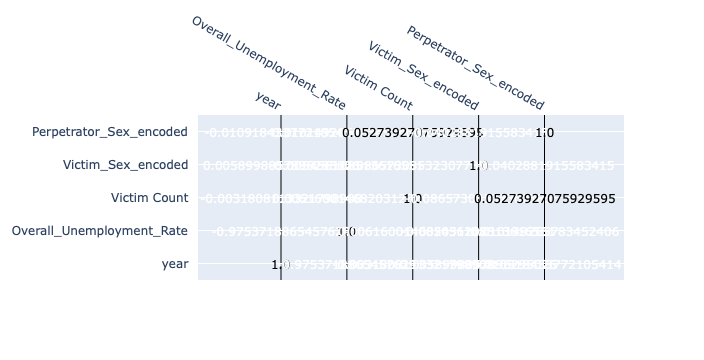

In [61]:

# for homicide data
selected_features = ['year', 'Overall_Unemployment_Rate', 'Victim Count', 
                     'Victim_Sex_encoded', 'Perpetrator_Sex_encoded']

correlation_matrix = merged_data[selected_features].corr().values

fig_corr = ff.create_annotated_heatmap(z=correlation_matrix, 
                                  x=selected_features, 
                                  y=selected_features)

fig_corr.show()


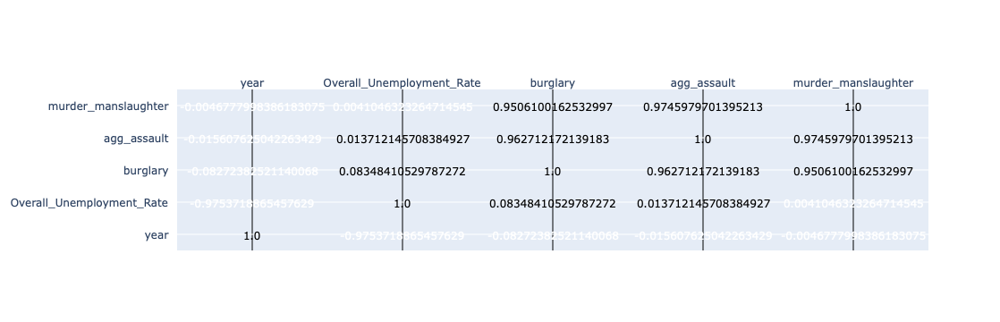

In [67]:
#crime

selected_features = ['year', 'Overall_Unemployment_Rate', 'burglary', 
                     'agg_assault', 'murder_manslaughter']

correlation_matrix = merged_data[selected_features].corr().values

fig_corr = ff.create_annotated_heatmap(z=correlation_matrix, 
                                  x=selected_features, 
                                  y=selected_features)

fig_corr.show()

In [61]:
victim_age_by_sex = merged_data.groupby('Victim Sex')['Victim Age'].mean()
print(victim_age_by_sex)

Victim Sex
Female    45.129856
Male      39.390708
Name: Victim Age, dtype: float64


In [63]:
import pandas as pd
from scipy.stats import zscore
import numpy as np

numeric_cols = merged_data.select_dtypes(include=[np.number]).columns#This line selects all the numeric columns from the dataset

merged_data_zscore = merged_data[numeric_cols].apply(zscore)#This line applies z-score scaling to the numeric columns. This scales the data so each column has a mean of 0 and a standard deviation of 1(I am pretty sure based on Tuesday's lecture). 

for i in numeric_cols:
    # Outliers are values where the z-score is less than -3 or greater than 3
    outliers = merged_data_zscore[(merged_data_zscore[i] < -3) | (merged_data_zscore[i] > 3)]
    
    # Print the column name and the number of outliers
    print(f"Column: {i}, Number of outliers: {len(outliers)}")


Column: year, Number of outliers: 0
Column: Victim Age, Number of outliers: 97
Column: Perpetrator Age, Number of outliers: 386
Column: Victim Count, Number of outliers: 835
Column: Perpetrator Count, Number of outliers: 944
Column: month, Number of outliers: 0
Column: Primary_School, Number of outliers: 0
Column: High_School, Number of outliers: 0
Column: Associates_Degree, Number of outliers: 0
Column: Professional_Degree, Number of outliers: 0
Column: White, Number of outliers: 0
Column: Black, Number of outliers: 0
Column: Asian, Number of outliers: 0
Column: Hispanic, Number of outliers: 0
Column: Men, Number of outliers: 0
Column: Women, Number of outliers: 0
Column: prisoner_count, Number of outliers: 0
Column: state_population, Number of outliers: 0
Column: violent_crime_total, Number of outliers: 0
Column: murder_manslaughter, Number of outliers: 0
Column: rape_legacy, Number of outliers: 0
Column: rape_revised, Number of outliers: 0
Column: robbery, Number of outliers: 0
Colu

# Model development 

### Model Evaluation and Comparison

* Linear regression was chosen because it is a baseline model for comparison and it is good for understanding relationships between variables. However, it can be sensitive to outliers. 
* Random Forest was chosen because it is robust to overfitting and can capture more complex interactions. Even though it has strong performance, it is computationally expensive. 
* KNN was chosen because it is simple and able to handle non-linear relationships. However, it does struggle with high-dimensional data. 

Coefficients:  [-3.60715551e-12 -1.32272665e-17  1.00000000e+00]
Variance score: 1.0
Mean Squared Error: 0.00
R-squared Score: 1.00


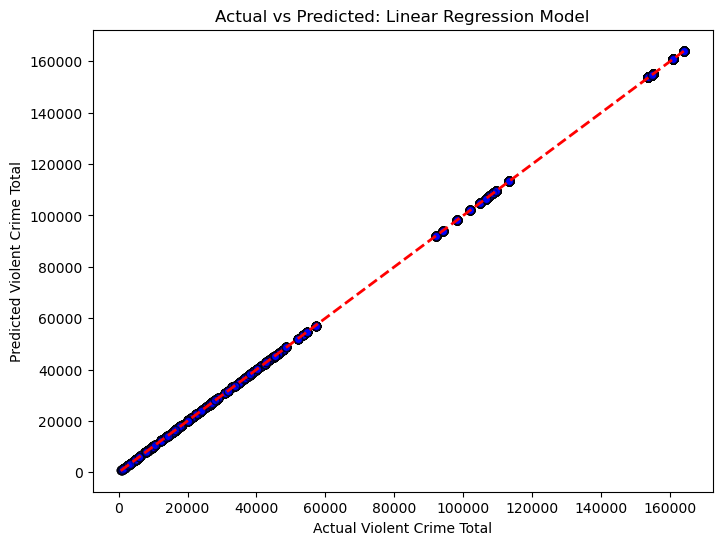

In [53]:
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error, r2_score

X = merged_data[['Overall_Unemployment_Rate', 'state_population', 'violent_crime_total']]
y = merged_data['violent_crime_total']

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

reg = LinearRegression()
reg.fit(X_train, y_train)
print('Coefficients: ', reg.coef_)
print('Variance score: {}'.format(reg.score(X_test, y_test)))

y_pred = reg.predict(X_test)

# Evaluate the model
mse = mean_squared_error(y_test, y_pred)
r2 = r2_score(y_test, y_pred)

print(f"Mean Squared Error: {mse:.2f}")
print(f"R-squared Score: {r2:.2f}")

plt.figure(figsize=(8, 6))
plt.scatter(y_test, y_pred, color='blue', edgecolor='k', alpha=0.6)
plt.plot([y.min(), y.max()], [y.min(), y.max()], 'r--', lw=2) 
plt.xlabel("Actual Violent Crime Total")
plt.ylabel("Predicted Violent Crime Total")
plt.title("Actual vs Predicted: Linear Regression Model")
plt.show()



Random Forest Regressor:
MSE: 2.879631341219828
RMSE: 1.6969476542368147
MAE: 0.06099861729928041
R^2: 0.9999999988920446

KNN Regressor:
MSE: 71921.81225380249
RMSE: 268.18242346172224
MAE: 38.90179751113846
R^2: 0.9999723276524716


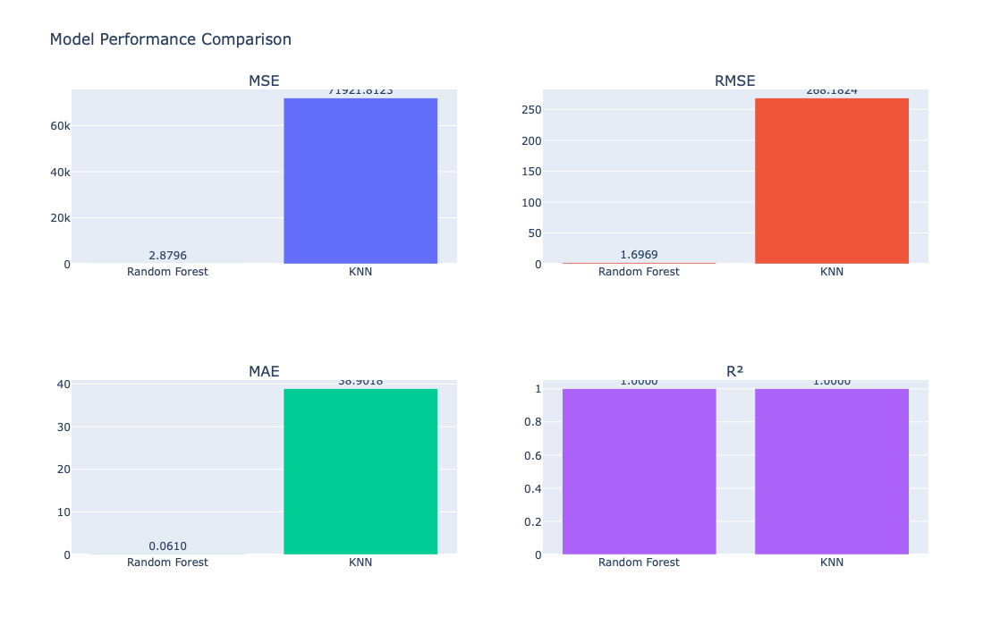

In [55]:
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.metrics import (
    mean_squared_error,
    mean_absolute_error,
    r2_score,
    root_mean_squared_error, 
)
from sklearn.ensemble import RandomForestRegressor
from sklearn.neighbors import KNeighborsRegressor
from sklearn.preprocessing import StandardScaler
from category_encoders import LeaveOneOutEncoder
import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots


X = merged_data[['Overall_Unemployment_Rate', 'state_population', 'burglary']]
y = merged_data['violent_crime_total']

X_train_rf, X_test_rf, y_train_rf, y_test_rf = train_test_split(X, y, test_size=0.2, random_state=42)

# Initialize and train a Random Forest Regressor
rf = RandomForestRegressor(n_estimators=100, n_jobs=-1, random_state=42)
rf.fit(X_train_rf, y_train_rf)

# Predict ratings using the Random Forest model
y_pred_rf = rf.predict(X_test_rf)

# Evaluate the Random Forest model using various metrics
mse_rf = mean_squared_error(y_test_rf, y_pred_rf)
rmse_rf = root_mean_squared_error(y_test_rf, y_pred_rf)
mae_rf = mean_absolute_error(y_test_rf, y_pred_rf)
r2_rf = r2_score(y_test_rf, y_pred_rf)

# Print Random Forest model performance metrics
print('Random Forest Regressor:')
print('MSE:', mse_rf)
print('RMSE:', rmse_rf)
print('MAE:', mae_rf)
print('R^2:', r2_rf)

# Add actual and predicted ratings to the test set for visualization
df_test_rf = X_test_rf.copy()
df_test_rf['Actual'] = y_test_rf.values
df_test_rf['Predicted'] = y_pred_rf


# Standardize features for the K-Nearest Neighbors (KNN) model
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

# Split the dataset into training and testing sets for the KNN model
X_train_knn, X_test_knn, y_train_knn, y_test_knn = train_test_split(X_scaled, y, test_size=0.2, random_state=42)

# Initialize and train a KNN Regressor
knn = KNeighborsRegressor(n_neighbors=5, n_jobs=-1)
knn.fit(X_train_knn, y_train_knn)

# Predict ratings using the KNN model
y_pred_knn = knn.predict(X_test_knn)

# Evaluate the KNN model using various metrics
mse_knn = mean_squared_error(y_test_knn, y_pred_knn)
rmse_knn = root_mean_squared_error(y_test_knn, y_pred_knn)
mae_knn = mean_absolute_error(y_test_knn, y_pred_knn)
r2_knn = r2_score(y_test_knn, y_pred_knn)

# Print KNN model performance metrics
print('\nKNN Regressor:')
print('MSE:', mse_knn)
print('RMSE:', rmse_knn)
print('MAE:', mae_knn)
print('R^2:', r2_knn)

# Prepare a DataFrame for KNN test results
df_test_knn = pd.DataFrame(X_test_knn, columns=X.columns)
df_test_knn['Actual'] = y_test_knn.values
df_test_knn['Predicted'] = y_pred_knn

# Combine metrics for both models into a summary DataFrame
metrics = {
    'Model': ['Random Forest', 'KNN'],
    'MSE': [mse_rf, mse_knn],
    'RMSE': [rmse_rf, rmse_knn],
    'MAE': [mae_rf, mae_knn],
    'R2': [r2_rf, r2_knn]
}
metrics_df = pd.DataFrame(metrics)

# Create subplots to visualize model performance comparison
fig = make_subplots(rows=2, cols=2, subplot_titles=('MSE', 'RMSE', 'MAE', 'R²'))

# Add performance metrics to the subplots as bar charts
fig.add_trace(go.Bar(x=metrics_df['Model'], y=metrics_df['MSE'], text=metrics_df['MSE']), row=1, col=1)
fig.add_trace(go.Bar(x=metrics_df['Model'], y=metrics_df['RMSE'], text=metrics_df['RMSE']), row=1, col=2)
fig.add_trace(go.Bar(x=metrics_df['Model'], y=metrics_df['MAE'], text=metrics_df['MAE']), row=2, col=1)
fig.add_trace(go.Bar(x=metrics_df['Model'], y=metrics_df['R2'], text=metrics_df['R2']), row=2, col=2)

# Update plot layout for better readability
fig.update_traces(texttemplate='%{text:.4f}', textposition='outside')
fig.update_layout(title_text='Model Performance Comparison', showlegend=False, height=700)

# Display the visualization
fig.show()

In [57]:
from sklearn.model_selection import cross_val_score

linear_cv_scores = cross_val_score(reg, X, y, cv=5, scoring='r2')
rf_cv_scores = cross_val_score(rf, X, y, cv=5, scoring='r2')
knn_cv_scores = cross_val_score(knn, X_scaled, y, cv=5, scoring='r2')

print("Linear Regression CV R² scores:", linear_cv_scores)
print("Random Forest CV R² scores:", rf_cv_scores)
print("KNN CV R² scores:", knn_cv_scores)
print("Average CV R² for Linear Regression:", linear_cv_scores.mean())
print("Average CV R² for Random Forest:", rf_cv_scores.mean())
print("Average CV R² for KNN:", knn_cv_scores.mean())

Linear Regression CV R² scores: [0.96913006 0.97455261 0.98117147 0.97934012 0.96550141]
Random Forest CV R² scores: [0.98864448 0.99022576 0.98391051 0.99377149 0.93856029]
KNN CV R² scores: [0.97589706 0.98037463 0.9694637  0.97929324 0.98812048]
Average CV R² for Linear Regression: 0.9739391359571631
Average CV R² for Random Forest: 0.9790225056931423
Average CV R² for KNN: 0.9786298198021534


In [67]:
from sklearn.tree import DecisionTreeClassifier
from sklearn.metrics import accuracy_score, classification_report
from sklearn.preprocessing import LabelEncoder

X = merged_data[['Overall_Unemployment_Rate', 'state_population', 'robbery']]
y = merged_data['high_crime']

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

classifier = DecisionTreeClassifier(max_depth=5, random_state=42)
classifier.fit(X_train, y_train)

y_pred = classifier.predict(X_test)

accuracy = accuracy_score(y_test, y_pred)
report = classification_report(y_test, y_pred)

print(f"Accuracy: {accuracy:.2f}")
print("Classification Report:")
print(report)


Accuracy: 0.98
Classification Report:
              precision    recall  f1-score   support

           0       0.96      0.99      0.98      3223
           1       0.99      0.96      0.97      3286

    accuracy                           0.98      6509
   macro avg       0.98      0.98      0.98      6509
weighted avg       0.98      0.98      0.98      6509



In [73]:
np.random.seed(1023)

p = 3  # Number of lags

# Create lagged matrix A and target vector b
def create_ar_matrix(data, p):
    data = np.array(data)
    
    # Create the lag matrix A
    A = np.column_stack([data[i:len(data)-p+i] for i in range(p)])
    
    # Create the target vector b
    b = data[p:]
    
    return A, b

# Generate A and b
A, b = create_ar_matrix(merged_data['Overall_Unemployment_Rate'], p)

# Print A and b shapes
print("Shape of A (lag matrix):", A.shape)
print("Shape of b (target vector):", b.shape)

# Solve for AR coefficients using np.linalg.solve
x = np.linalg.solve(A.T @ A, A.T @ b)

print("AR Coefficients:", x)

# Split the data into training and testing sets (80/20 split)
train_size = int(len(b) * 0.8)
A_train, A_test = A[:train_size], A[train_size:]
b_train, b_test = b[:train_size], b[train_size:]

# Fit the model on training data
x_train = np.linalg.solve(A_train.T @ A_train, A_train.T @ b_train) # A_train.T and A_Train should result in the identity matrix

# Predict on test data
b_pred = A_test @ x_train #use the predicted value of b to calculate the MSE later on

# Calculate the Mean Squared Error (MSE)
mse = np.mean((b_test - b_pred) ** 2)
print(f"Mean Squared Error (MSE): {mse}")


Shape of A (lag matrix): (32542, 3)
Shape of b (target vector): (32542,)
AR Coefficients: [0.24221728 0.21417645 0.54333027]
Mean Squared Error (MSE): 0.09577419275454364


In [83]:

df = pd.DataFrame({"Overall_Unemployment_Rate": merged_data["Overall_Unemployment_Rate"],"High Crime": merged_data['high_crime']})


def create_lagged_features(data, lags):
    df = pd.DataFrame(data)
    columns = [df.shift(i) for i in range(1, lags + 1)]
    df = pd.concat(columns, axis=1)
    df.columns = ['Lag_' + str(i) for i in range(1, lags + 1)]
    df['Target'] = data
    return df.dropna()

lags = 3  # Number of lags

# Temperature using precipitation
df_unemployment_using_high_crime = create_lagged_features(df['High Crime'], lags)
df_unemployment_using_high_crime['Overall_Unemployment_Rate'] = df['Overall_Unemployment_Rate'][lags:].values

# Precipitation using temperature
df_high_crime_using_unemployment = create_lagged_features(df['Overall_Unemployment_Rate'], lags)
df_high_crime_using_unemployment ['High Crime'] = df['High Crime'][lags:].values

# train-test split for temperature using precip
train_size_temp = int(len(df_unemployment_using_high_crime) * 0.8)
train_temp, test_temp = df_unemployment_using_high_crime[:train_size_temp], df_unemployment_using_high_crime[train_size_temp:]

#train-test split for precip using temperature
train_size_precip = int(len(df_high_crime_using_unemployment) * 0.8)
train_precip, test_precip = df_high_crime_using_unemployment[:train_size_precip], df_high_crime_using_unemployment[train_size_precip:]

def fit_ar_model(df):
    X = df.iloc[:, :-1].values
    y = df.iloc[:, -1].values
    X = np.c_[np.ones(X.shape[0]), X]  
    beta = np.linalg.inv(X.T @ X) @ (X.T @ y)
    return beta

beta_temp_using_precip = fit_ar_model(train_temp)

beta_precip_using_temp = fit_ar_model(train_precip)


def evaluate_ar_model(beta, df):
    X = df.iloc[:, :-1].values
    y = df.iloc[:, -1].values
    X = np.c_[np.ones(X.shape[0]), X]  # Adding a column of ones for the intercept
    y_pred = X @ beta
    mse = np.mean((y - y_pred) ** 2)
    return mse

mse_temp_using_precip = evaluate_ar_model(beta_temp_using_precip, test_temp)

mse_precip_using_temp = evaluate_ar_model(beta_precip_using_temp, test_precip)

print(f"MSE for Temperature using Precipitation: {mse_temp_using_precip}")
print(f"MSE for Precipitation using Temperature: {mse_precip_using_temp}")

MSE for Temperature using Precipitation: 6.34293134098738
MSE for Precipitation using Temperature: 0.2515034917664271


## Plots I am most likely or forsure using

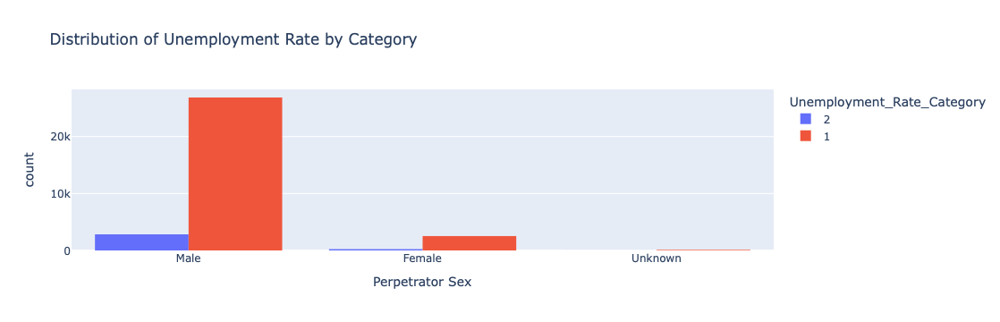

In [89]:
fig1 = px.histogram(merged_data, x='Perpetrator Sex', color='Unemployment_Rate_Category',  # Use the new encoded column for color
                    title='Distribution of Unemployment Rate by Category', 
                    barmode='group',
                    labels={'Perpetrator Sex': 'Perpetrator Sex'})
fig1

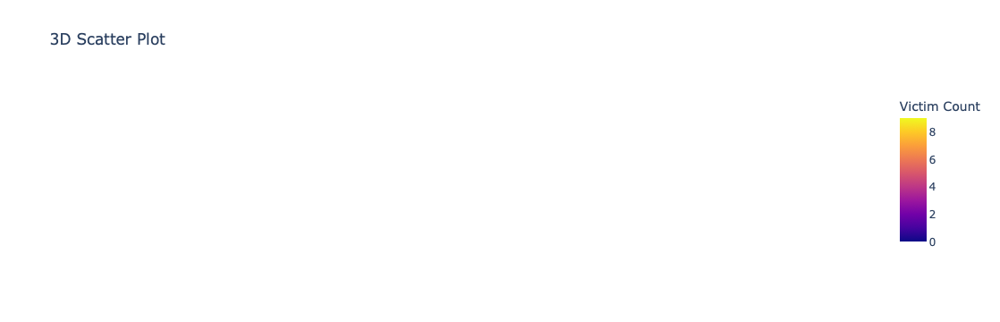

In [91]:
fig2 = px.scatter_3d(merged_data, x='year', y='Overall_Unemployment_Rate', z='Perpetrator_Sex_encoded', 
                    title='3D Scatter Plot',
                    labels={'year':'Year','Overall_Unemployment_Rate': 'Unemployment Rate (%)','Perpetrator_Sex_encoded':'Perpetrator Sex' },
                    color = "Victim Count")
fig2.show()

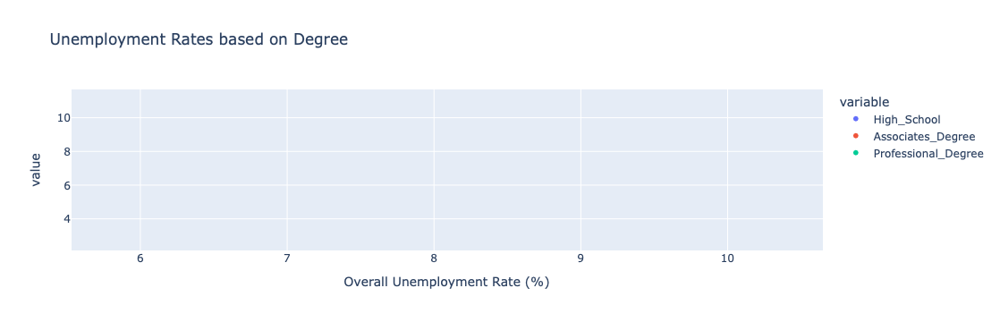

In [93]:
fig3 = px.scatter(merged_data, x='Overall_Unemployment_Rate', y=['High_School','Associates_Degree','Professional_Degree'], 
           labels={'Overall_Unemployment_Rate': 'Overall Unemployment Rate (%)'},
              title='Unemployment Rates based on Degree')
fig3.show()

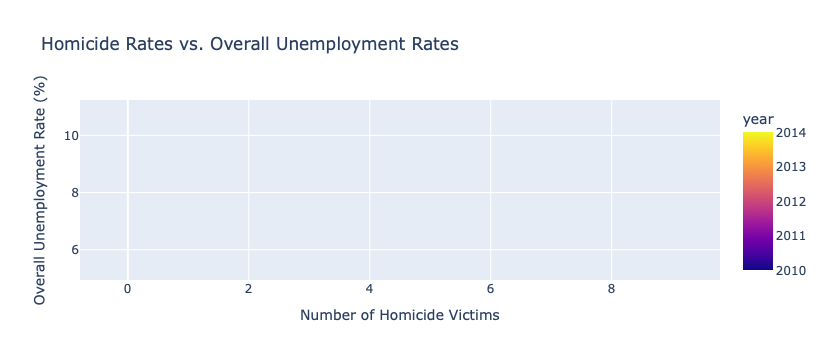

In [95]:
fig4 = px.scatter(merged_data, x='Victim Count', y='Overall_Unemployment_Rate',color='year', size = 'year',
    title='Homicide Rates vs. Overall Unemployment Rates',
    labels={'Overall_Unemployment_Rate': ' Overall Unemployment Rate (%)', 'Victim Count': 'Number of Homicide Victims'})
fig4.show()

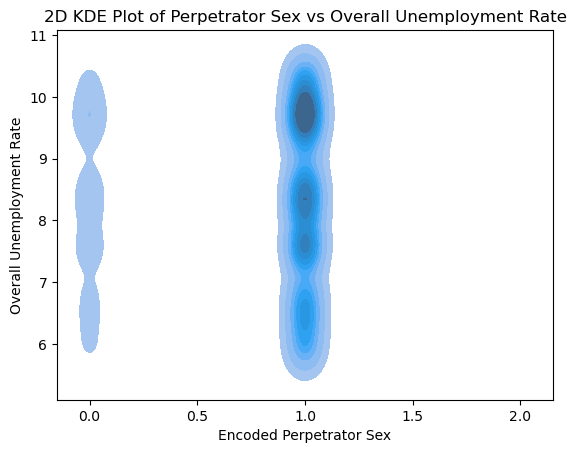

In [97]:
fig5 = sns.kdeplot(data=merged_data, x="Perpetrator_Sex_encoded", y="Overall_Unemployment_Rate", fill=True)

plt.title("2D KDE Plot of Perpetrator Sex vs Overall Unemployment Rate")
plt.xlabel("Encoded Perpetrator Sex")
plt.ylabel("Overall Unemployment Rate")

plt.show()

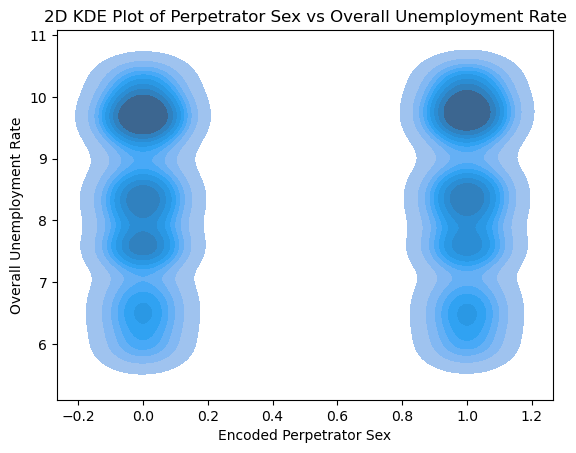

In [104]:
fig6 = sns.kdeplot(data=merged_data, x="high_crime", y="Overall_Unemployment_Rate", fill=True)

plt.title("2D KDE Plot of High Crime vs Overall Unemployment Rate")
plt.xlabel("High Crime")
plt.ylabel("Overall Unemployment Rate")

plt.show()

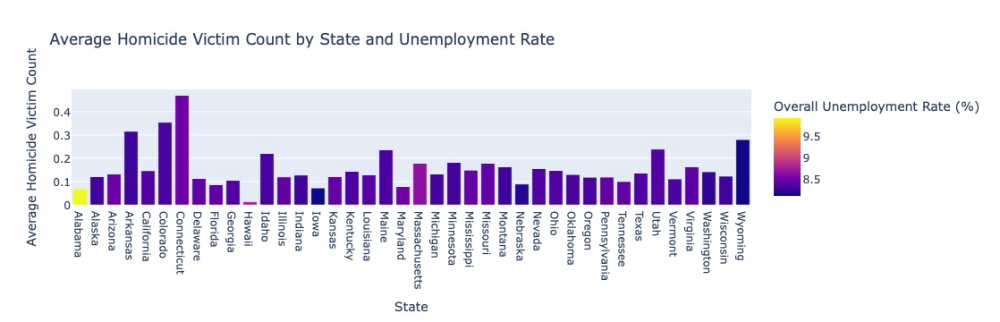

In [99]:
fig7 = px.bar(
    merged_data.groupby('State')[['Victim Count', 'Overall_Unemployment_Rate']].mean().reset_index(),
    x='State',
    y='Victim Count',
    color='Overall_Unemployment_Rate',
    title='Average Homicide Victim Count by State and Unemployment Rate',
    labels={'Victim Count': 'Average Homicide Victim Count', 'Overall_Unemployment_Rate': ' Overall Unemployment Rate (%)'}
)
fig7.show()

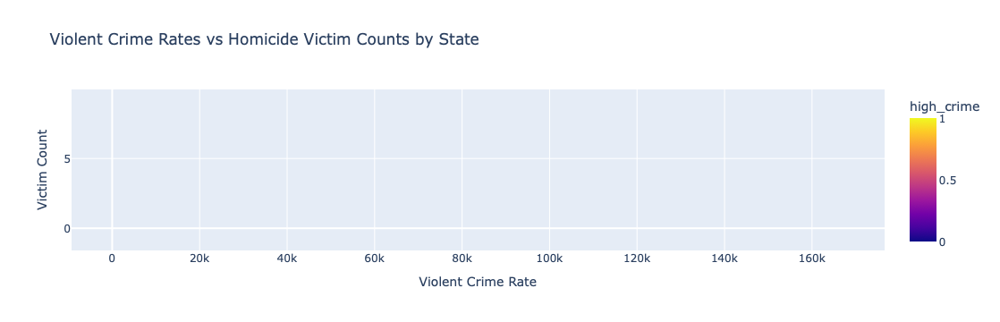

In [70]:
import plotly.express as px

fig8 = px.scatter(
    merged_data,
    x="violent_crime_total",
    y="Victim Count",
    size="state_population",
    color="high_crime",
    title="Violent Crime Rates vs Homicide Victim Counts by High Crime",
    labels={"violent_crime_total": "Violent Crime Rate", "victim_count": "Homicide Victim Count"},
)

fig8


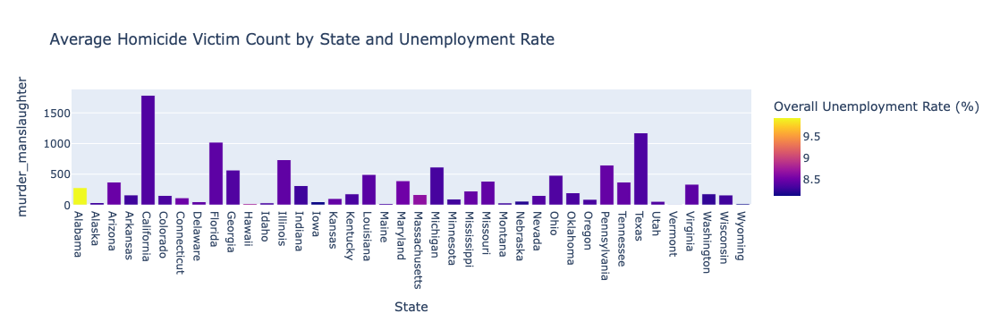

In [122]:
fig9 = px.bar(
    merged_data.groupby('State')[['murder_manslaughter', 'Overall_Unemployment_Rate']].mean().reset_index(),
    x='State',
    y='murder_manslaughter',
    color='Overall_Unemployment_Rate',
    title='Average Manslaughter Count by State and Unemployment Rate',
    labels={'Victim Count': 'Average Homicide Victim Count', 'Overall_Unemployment_Rate': ' Overall Unemployment Rate (%)'}
)
fig9.show()

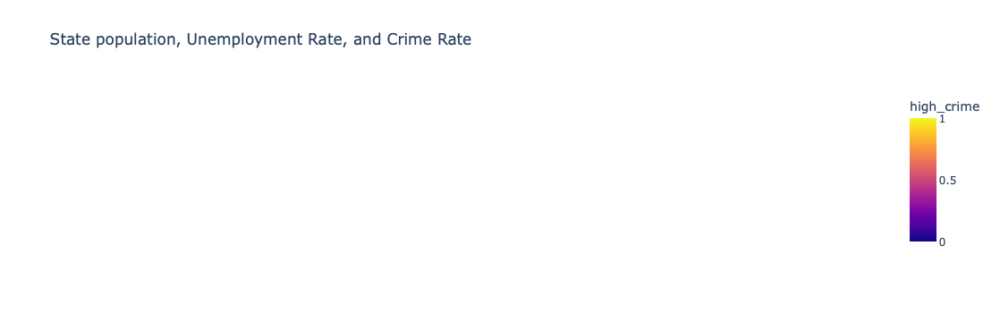

In [67]:
fig10 = px.scatter_3d(
    merged_data,
    x="state_population",
    y="Overall_Unemployment_Rate",
    z="violent_crime_total",
    color="high_crime",
    title="State population, Unemployment Rate, and Crime Rate",
    labels={"state_population": "Population", "Overall_Unemployment Rate": "Unemployment Rate", "violent_crime_total": "Violent Crime Rate"},
)
fig10


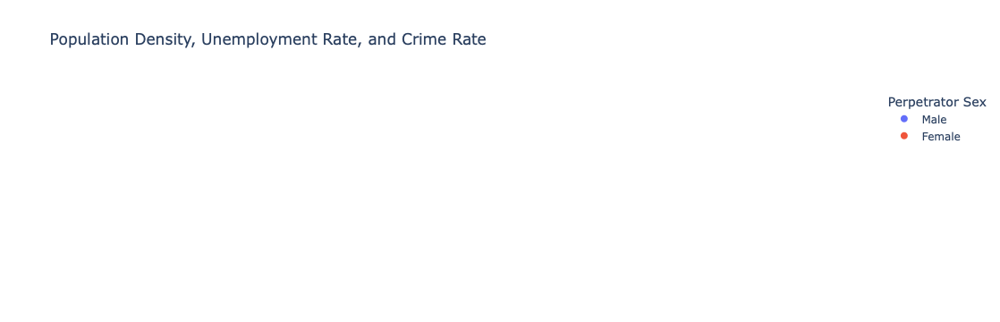

In [80]:
fig11 = px.scatter_3d(
    merged_data,
    x="burglary",
    y="agg_assault",
    z="murder_manslaughter",
    color="Perpetrator Sex",
    title="Burglary, Agg Assault, and Murder Manslaughter",
    labels={"burglary": "Burglary", "agg_assault": "Assault", "murder_manslaughter": "Mansluaghter"},
)
fig11

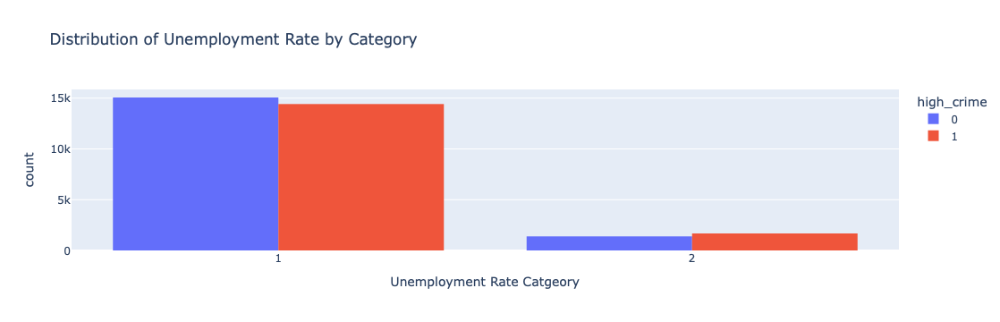

In [118]:
fig12 = px.histogram(merged_data, x='Unemployment_Rate_Category', color='high_crime',  # Use the new encoded column for color
                    title='Distribution of Unemployment Rate by High Crime', 
                    barmode='group',
                    labels={'Unemployment_Rate_Category': 'Unemployment Rate Catgeory'})
fig12